<a href="https://colab.research.google.com/github/Walaakhaled4/ASDC/blob/master/Copy_of_segmentaion_player.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


Import libs

In [ ]:
# Common
import os
import keras
import numpy as np
import pandas as pd
import tensorflow as tf

# Data
from glob import glob
from tqdm import tqdm
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visualization
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import plot_model
import sys
import skimage.io
# Model
from keras.layers import add
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import multiply
from keras.layers import Dropout
from keras.layers import MaxPool2D
from keras.layers import Concatenate
from keras.layers import Conv2DTranspose
from keras.layers import BatchNormalization
from keras.callbacks import Callback, ModelCheckpoint
from keras.models import Model
# Model Visualization
from tensorflow.keras.utils import plot_model

Read Data

In [ ]:
# read data path
image_paths = '/content/drive/MyDrive/footballer/images*/'

# All Images and thier respective maps
all_images = glob(image_paths + "*.jpg")
all_paths = [path.replace(".jpg",".jpg___fuse.png") for path in all_images]

In [ ]:
#check len
print(len(all_images))
print(len(all_paths))
print(len(image_paths))

100
100
42


In [ ]:
all_images[2]

'/content/drive/MyDrive/footballer/images/Frame 1  (21).jpg'

In [ ]:
all_paths[2]

'/content/drive/MyDrive/footballer/images/Frame 1  (21).jpg___fuse.png'

Data Visualization

In [ ]:
def load_image(path, SIZE=256):
    image = load_img(path)
    image = tfi.resize(image, (SIZE, SIZE))
    image = img_to_array(image)
    image = tf.cast(image, tf.float32)
    image = image/255.
    return image

def load_data(image_paths, label_paths, SIZE=256):
    images, label_maps = np.zeros(shape=(len(image_paths), SIZE, SIZE, 3)), np.zeros(shape=(len(label_paths), SIZE, SIZE, 3))
    for i, (image_path, label_path) in tqdm(enumerate(zip(image_paths, label_paths)), desc="Loading"):
        image, label_map = load_image(image_path, SIZE=SIZE), load_image(label_path, SIZE=SIZE)
        images[i], label_maps[i] = image, label_map
    return images, label_maps

In [ ]:
images, label_maps = load_data(all_images, all_paths)

Loading: 100it [00:11,  8.85it/s]


In [ ]:
def show_map(image, label_map, alpha_1=1, alpha_2=0.7):
    plt.imshow(image, alpha=alpha_1)
    plt.imshow(label_map, alpha=alpha_2)
    plt.axis('off')

In [ ]:
def show_maps(images, label_maps, GRID=[5,6], SIZE=(25,25)):

    # Plot Configuration
    n_rows, n_cols = GRID
    n_images = n_rows * n_cols
    plt.figure(figsize=SIZE)

    # Iterate through the Data
    i=1
    for image, label_map in zip(images, label_maps):

        # Plot Image
        plt.subplot(n_rows, n_cols, i)
        show_map(image, label_map)

        i+=1
        if i>n_images:
            break

    # Final Plot
    plt.show()

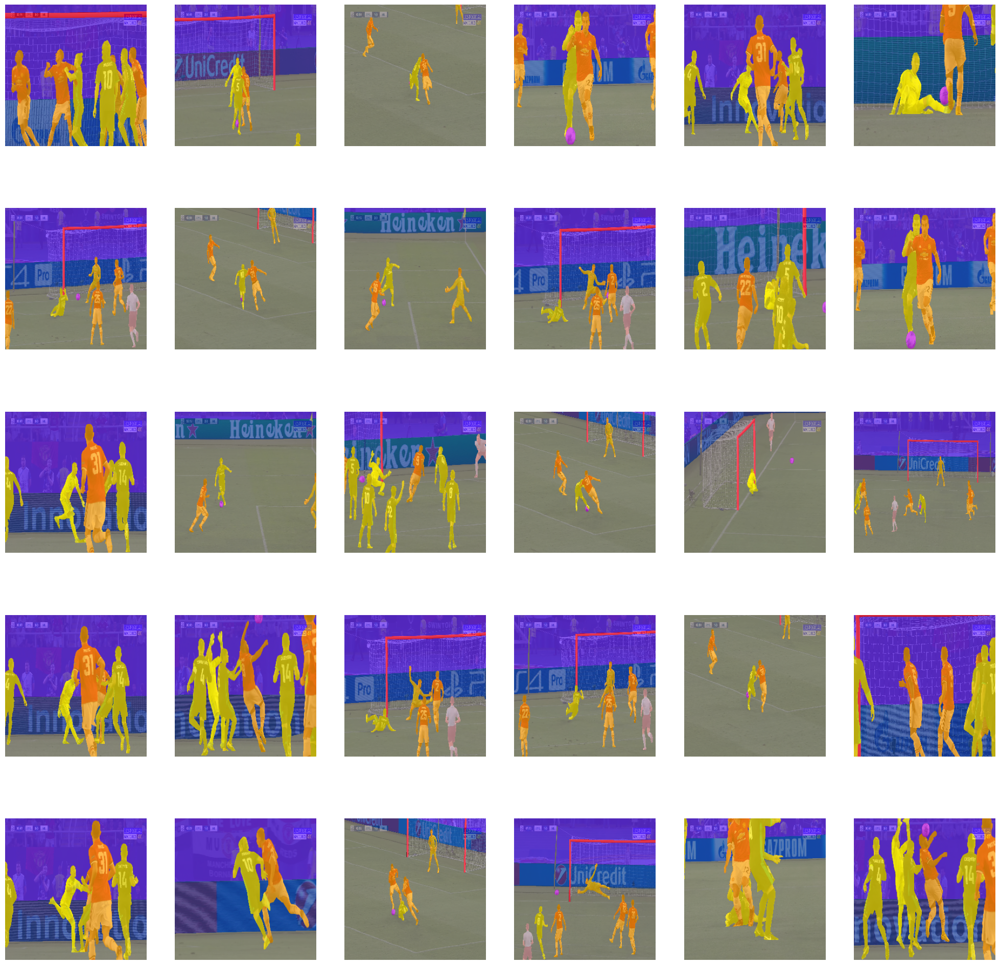

In [ ]:
show_maps(images, label_maps)

Split Data

In [ ]:
train_images, test_images, train_labels, test_labels = train_test_split(images, label_maps, test_size=0.2, random_state=42)

U-Net Encoder

In [ ]:
def encoder(X, filters, rate=0.2, pooling=True):
    x = BatchNormalization()(X)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu',
               kernel_initializer='he_normal')(x)
    x = Dropout(rate)(x)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu',
               kernel_initializer='he_normal')(x)
    if pooling:
        y = MaxPool2D()(x)
        return x, y
    return x

U-Net Decoder

In [ ]:
def decoder(x, skip_x, filters, rate):
    y = Conv2DTranspose(filters, kernel_size=3, strides=2, padding='same', activation='relu',
                        kernel_initializer='he_normal')(BatchNormalization()(x))
    y = encoder(Concatenate()([y, skip_x]), filters, rate, pooling=False)
    return y

U-Net Architechture

In [ ]:

# Input Layer
InputL = Input(shape=(256, 256, 3), name="InputImage")

# Encoder Block
c1, p1 = encoder(InputL, filters=64, rate=0.1)
c2, p2 = encoder(p1, filters=128, rate=0.1)
c3, p3 = encoder(p2, filters=256, rate=0.2)
c4, p4 = encoder(p3, filters=512, rate=0.2)

# Encoding Layer
encodings = encoder(p4, filters=512, rate=0.3, pooling=False)

# Decoder Block
d = decoder(encodings, c4, filters=512, rate=0.2)
d = decoder(d, c3, filters=256, rate=0.2)
d = decoder(d, c2, filters=128, rate=0.1)
d = decoder(d, c1, filters=64, rate=0.1)

# Output
conv_out = Conv2D(3, kernel_size=3, padding='same', activation='sigmoid', name="Segmentator")(d)


In [ ]:
# Model
model = Model(InputL, conv_out, name="UNet")
model.summary()

Model: "UNet"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputImage (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 3)          12        ['InputImage[0][0]']          
 Normalization)                                                                                   
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['batch_normalization[0][0]'] 
                                                                                                  
 dropout (Dropout)           (None, 256, 256, 64)         0         ['conv2d[0][0]']           

In [ ]:
# Compile Model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

Visualization Model

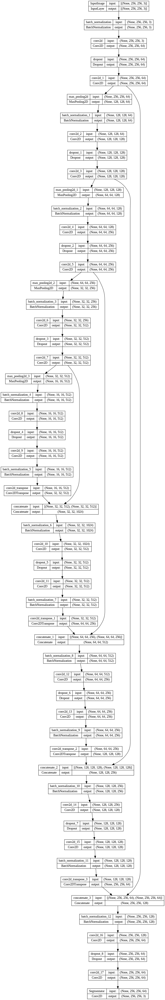

In [ ]:
plot_model(model, "UNet.png", show_shapes=True)

Training Model

In [ ]:
BATCH_SIZE = 15
SPE = len(images)//BATCH_SIZE

In [ ]:
def show_image(image, title=None):
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')

In [ ]:
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        id = np.random.randint(len(images))
        image = images[id]
        mask = label_maps[id]
        pred_mask = self.model(tf.expand_dims(image,axis=0))[0]

        plt.figure(figsize=(10,8))
        plt.subplot(1,3,1)
        show_image(image, title="Original Image")

        plt.subplot(1,3,2)
        show_image(mask, title="Original Mask")

        plt.subplot(1,3,3)
        show_image(pred_mask, title="Predicted Mask")

        plt.tight_layout()
        plt.show()

In [ ]:
check_point = [ModelCheckpoint("Segmentation.h5", save_best_only=True),ShowProgress()]

UNet Fitting

Epoch 1/30
6/6 [==============================] - ETA: 0s - loss: 0.7680 - accuracy: 0.5611  

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


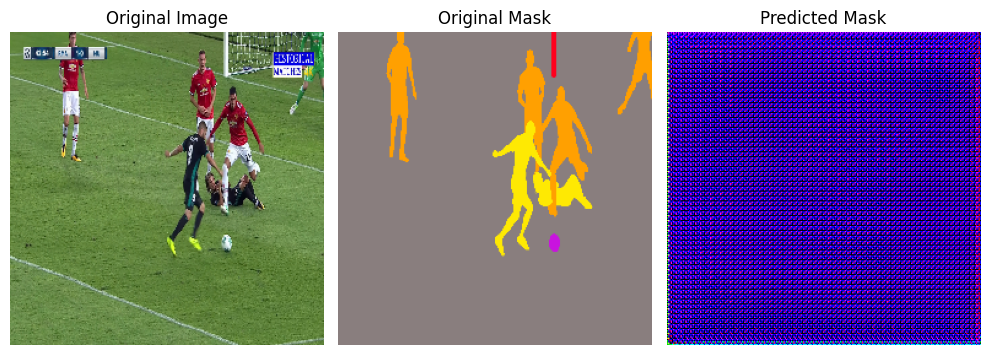

6/6 [==============================] - 733s 122s/step - loss: 0.7680 - accuracy: 0.5611 - val_loss: 93.5758 - val_accuracy: 0.5011
Epoch 2/30
6/6 [==============================] - ETA: 0s - loss: 0.6768 - accuracy: 0.5532  

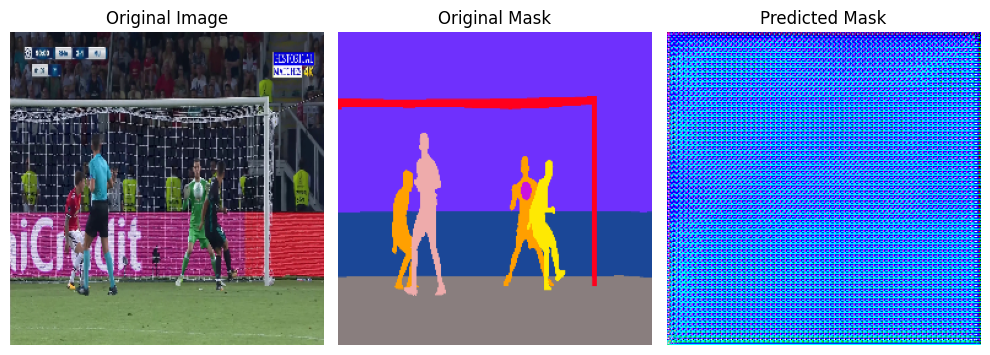

6/6 [==============================] - 701s 118s/step - loss: 0.6768 - accuracy: 0.5532 - val_loss: 37.7696 - val_accuracy: 0.3931
Epoch 3/30
6/6 [==============================] - ETA: 0s - loss: 0.6384 - accuracy: 0.7757  

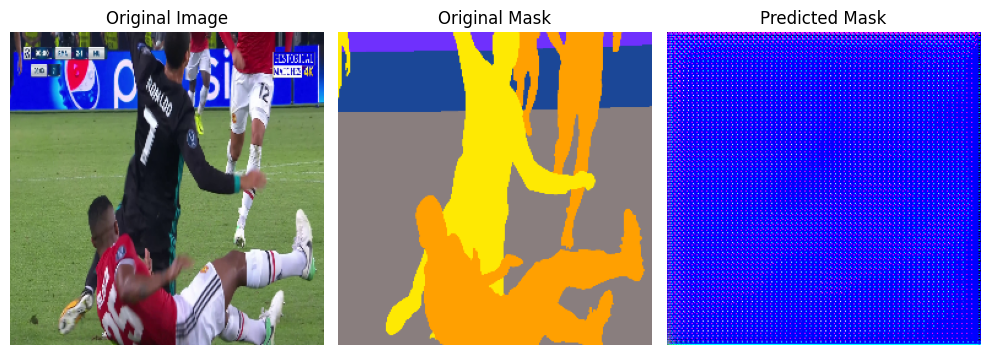

6/6 [==============================] - 727s 122s/step - loss: 0.6384 - accuracy: 0.7757 - val_loss: 26.0979 - val_accuracy: 0.4842
Epoch 4/30
6/6 [==============================] - ETA: 0s - loss: 0.6167 - accuracy: 0.6829  

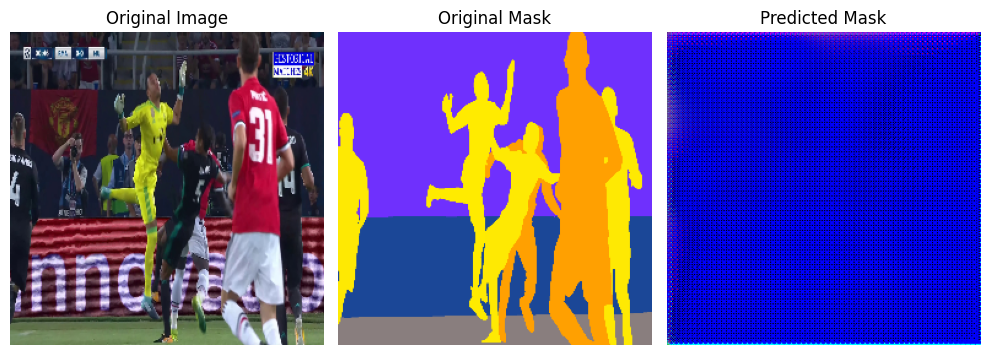

6/6 [==============================] - 684s 114s/step - loss: 0.6167 - accuracy: 0.6829 - val_loss: 14.4219 - val_accuracy: 0.4849
Epoch 5/30
6/6 [==============================] - ETA: 0s - loss: 0.6024 - accuracy: 0.8005  

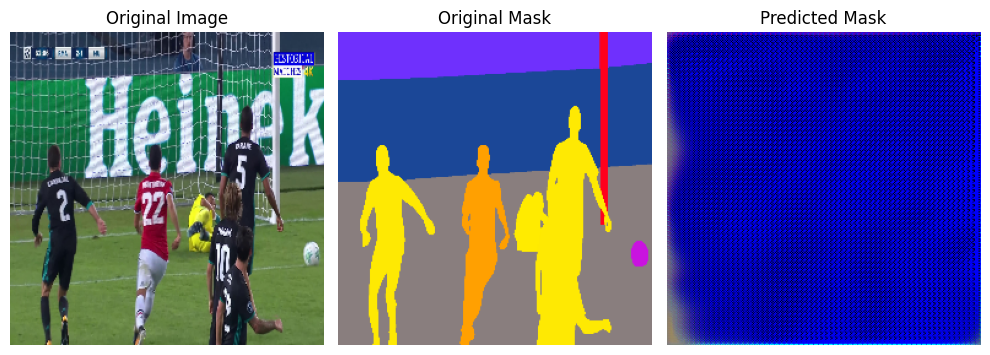

6/6 [==============================] - 682s 115s/step - loss: 0.6024 - accuracy: 0.8005 - val_loss: 10.1454 - val_accuracy: 0.4887
Epoch 6/30
6/6 [==============================] - ETA: 0s - loss: 0.5861 - accuracy: 0.8284  

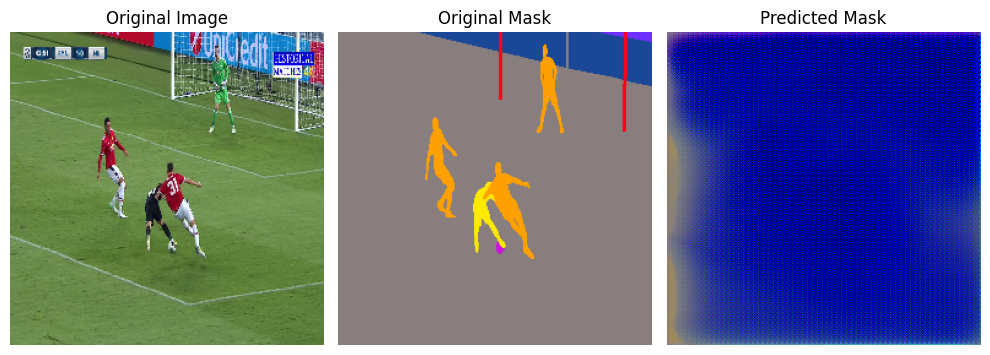

6/6 [==============================] - 706s 120s/step - loss: 0.5861 - accuracy: 0.8284 - val_loss: 4.2885 - val_accuracy: 0.4916
Epoch 7/30
6/6 [==============================] - ETA: 0s - loss: 0.5784 - accuracy: 0.8029  

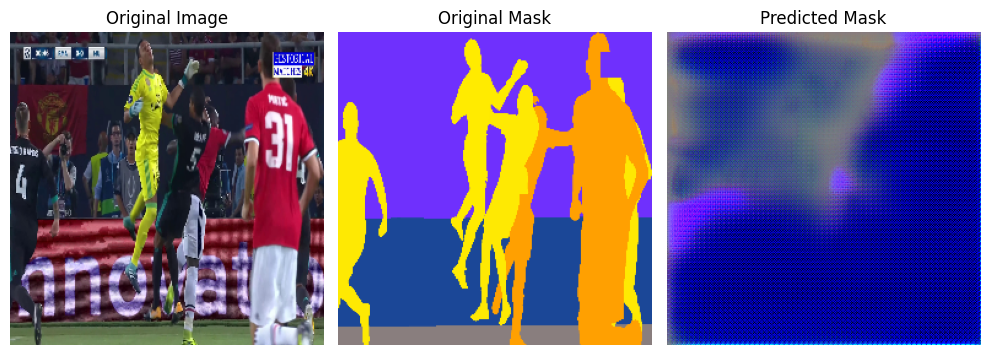

6/6 [==============================] - 710s 120s/step - loss: 0.5784 - accuracy: 0.8029 - val_loss: 1.7631 - val_accuracy: 0.4910
Epoch 8/30
6/6 [==============================] - ETA: 0s - loss: 0.5692 - accuracy: 0.8164  

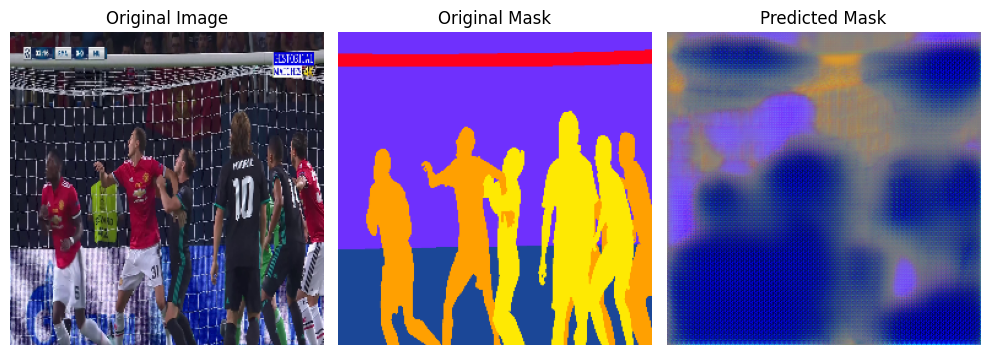

6/6 [==============================] - 690s 116s/step - loss: 0.5692 - accuracy: 0.8164 - val_loss: 1.0879 - val_accuracy: 0.4465
Epoch 9/30
6/6 [==============================] - ETA: 0s - loss: 0.5660 - accuracy: 0.8230  

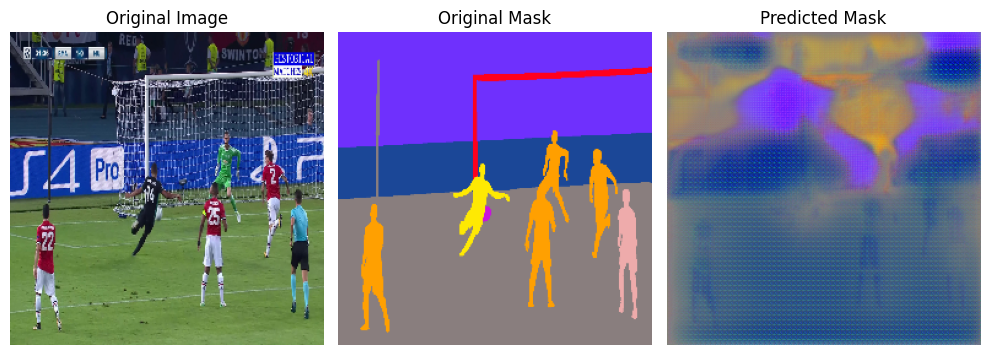

6/6 [==============================] - 704s 119s/step - loss: 0.5660 - accuracy: 0.8230 - val_loss: 0.7562 - val_accuracy: 0.3501
Epoch 10/30
6/6 [==============================] - ETA: 0s - loss: 0.5606 - accuracy: 0.8041  

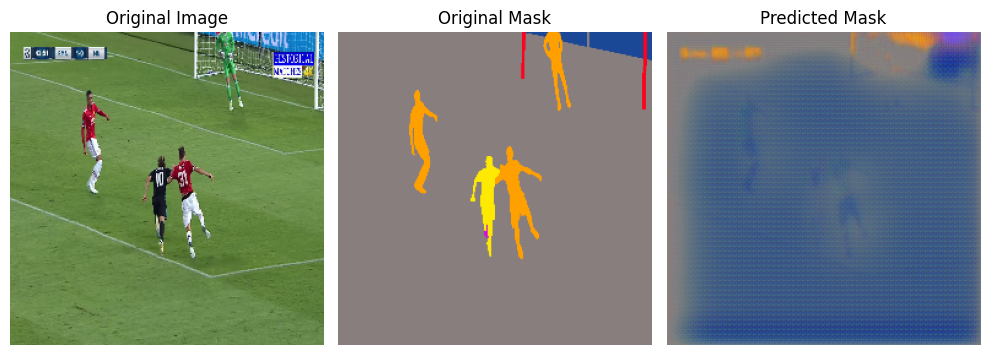

6/6 [==============================] - 721s 121s/step - loss: 0.5606 - accuracy: 0.8041 - val_loss: 0.7369 - val_accuracy: 0.2987
Epoch 11/30
6/6 [==============================] - ETA: 0s - loss: 0.5591 - accuracy: 0.8449  

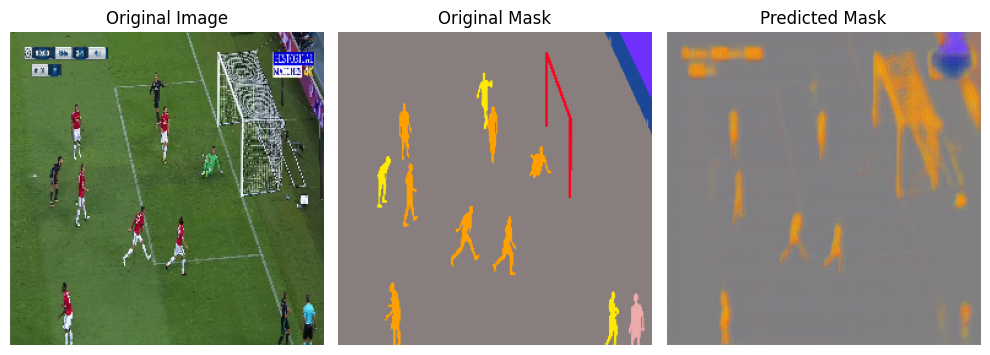

6/6 [==============================] - 690s 116s/step - loss: 0.5591 - accuracy: 0.8449 - val_loss: 0.6916 - val_accuracy: 0.5420
Epoch 12/30
6/6 [==============================] - ETA: 0s - loss: 0.5692 - accuracy: 0.8000  

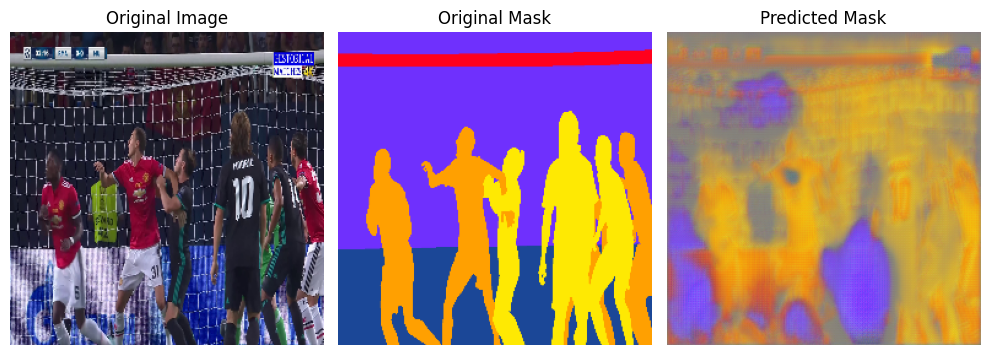

6/6 [==============================] - 682s 115s/step - loss: 0.5692 - accuracy: 0.8000 - val_loss: 0.7039 - val_accuracy: 0.5569
Epoch 13/30
6/6 [==============================] - ETA: 0s - loss: 0.5590 - accuracy: 0.8545  

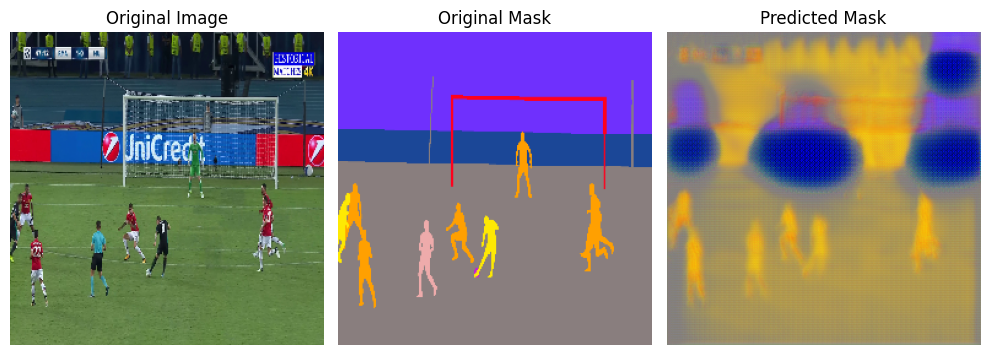

6/6 [==============================] - 686s 115s/step - loss: 0.5590 - accuracy: 0.8545 - val_loss: 0.7989 - val_accuracy: 0.6412
Epoch 14/30
6/6 [==============================] - ETA: 0s - loss: 0.5542 - accuracy: 0.7951  

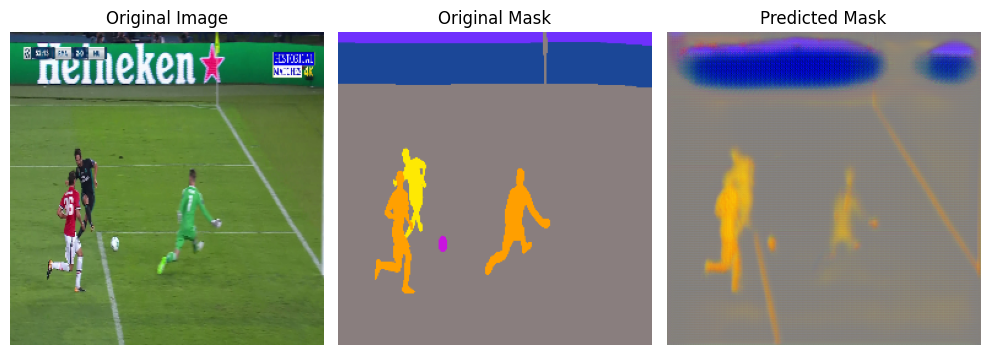

6/6 [==============================] - 683s 115s/step - loss: 0.5542 - accuracy: 0.7951 - val_loss: 0.6895 - val_accuracy: 0.6785
Epoch 15/30
6/6 [==============================] - ETA: 0s - loss: 0.5541 - accuracy: 0.8828  

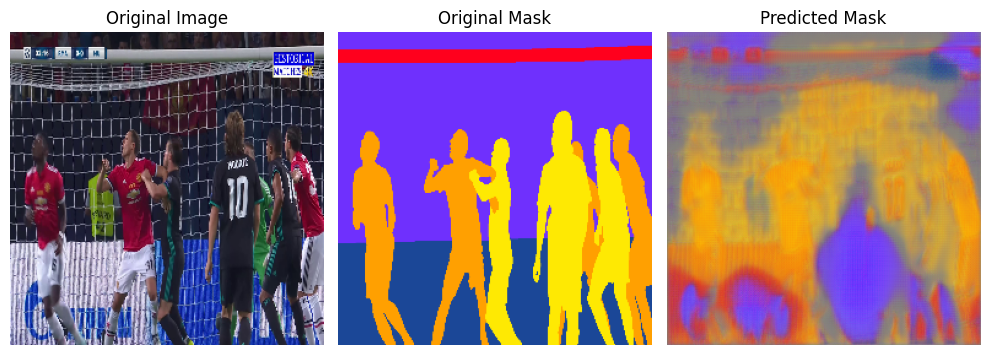

6/6 [==============================] - 685s 115s/step - loss: 0.5541 - accuracy: 0.8828 - val_loss: 0.6752 - val_accuracy: 0.7795
Epoch 16/30
6/6 [==============================] - ETA: 0s - loss: 0.5520 - accuracy: 0.8412  

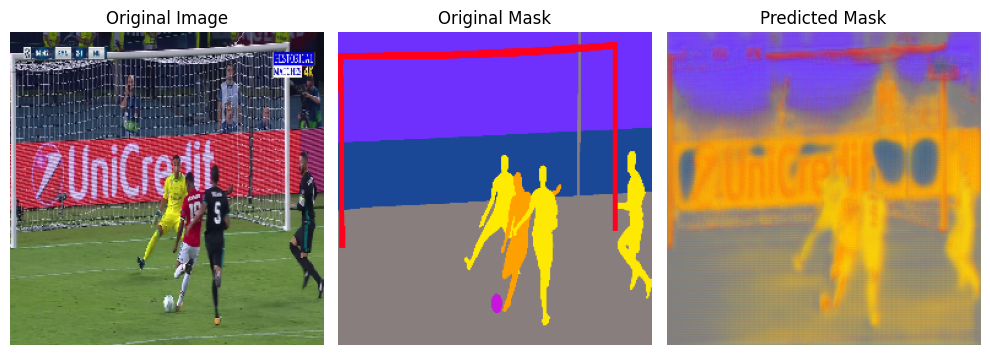

6/6 [==============================] - 683s 114s/step - loss: 0.5520 - accuracy: 0.8412 - val_loss: 0.7217 - val_accuracy: 0.7200
Epoch 17/30
6/6 [==============================] - ETA: 0s - loss: 0.5497 - accuracy: 0.8697  

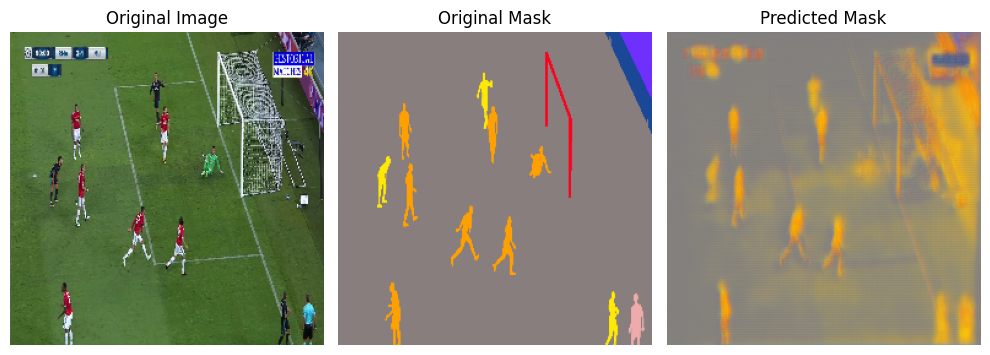

6/6 [==============================] - 709s 119s/step - loss: 0.5497 - accuracy: 0.8697 - val_loss: 0.6603 - val_accuracy: 0.7246
Epoch 18/30
6/6 [==============================] - ETA: 0s - loss: 0.5443 - accuracy: 0.8304  

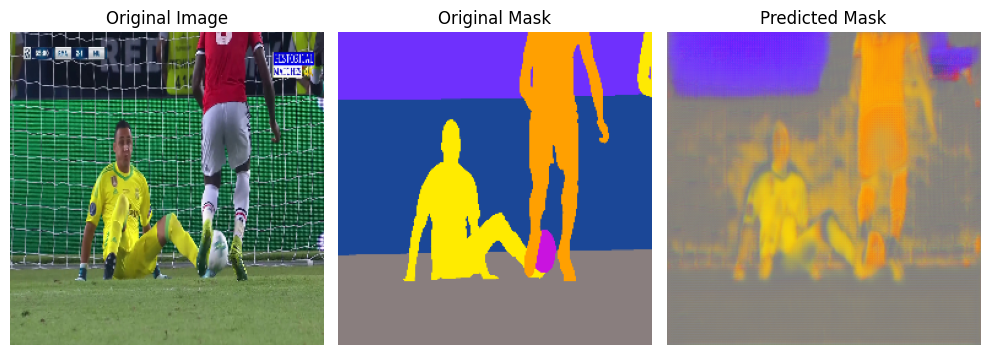

6/6 [==============================] - 713s 119s/step - loss: 0.5443 - accuracy: 0.8304 - val_loss: 0.6494 - val_accuracy: 0.8026
Epoch 19/30
6/6 [==============================] - ETA: 0s - loss: 0.5408 - accuracy: 0.8709  

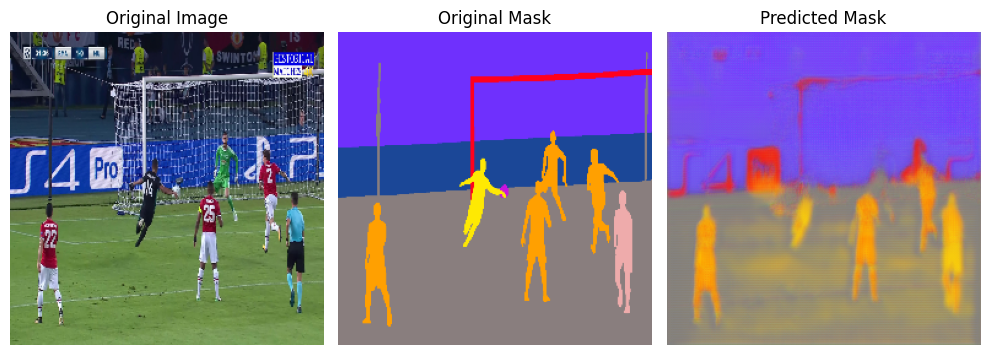

6/6 [==============================] - 709s 119s/step - loss: 0.5408 - accuracy: 0.8709 - val_loss: 0.6588 - val_accuracy: 0.8422
Epoch 20/30
6/6 [==============================] - ETA: 0s - loss: 0.5400 - accuracy: 0.8932  

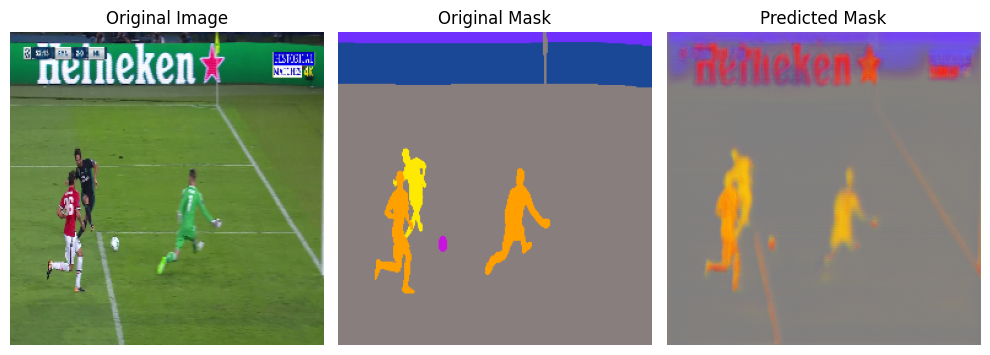

6/6 [==============================] - 713s 121s/step - loss: 0.5400 - accuracy: 0.8932 - val_loss: 0.6434 - val_accuracy: 0.8324
Epoch 21/30
6/6 [==============================] - ETA: 0s - loss: 0.5356 - accuracy: 0.8404  

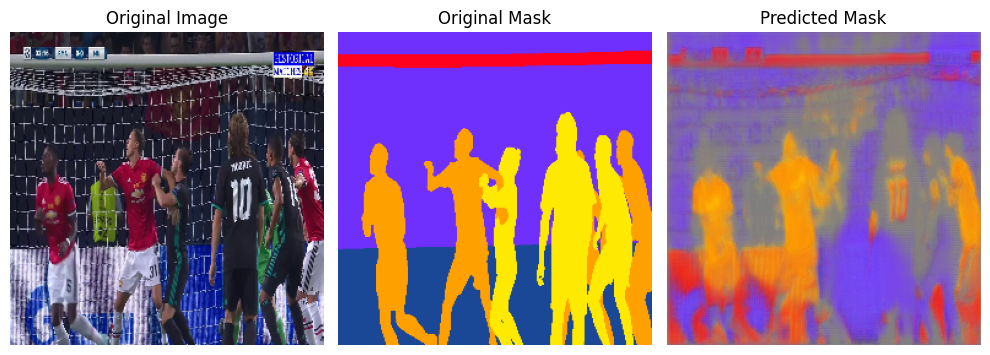

6/6 [==============================] - 688s 116s/step - loss: 0.5356 - accuracy: 0.8404 - val_loss: 0.6390 - val_accuracy: 0.8364
Epoch 22/30
6/6 [==============================] - ETA: 0s - loss: 0.5337 - accuracy: 0.8858  

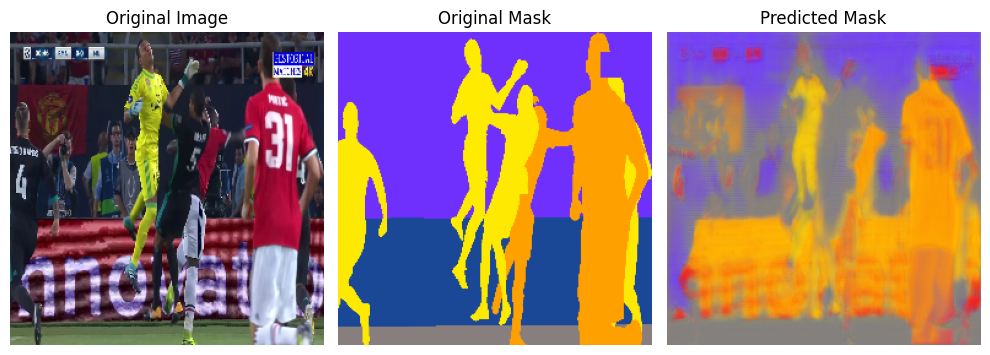

6/6 [==============================] - 685s 115s/step - loss: 0.5337 - accuracy: 0.8858 - val_loss: 0.6393 - val_accuracy: 0.8488
Epoch 23/30
6/6 [==============================] - ETA: 0s - loss: 0.5319 - accuracy: 0.8953  

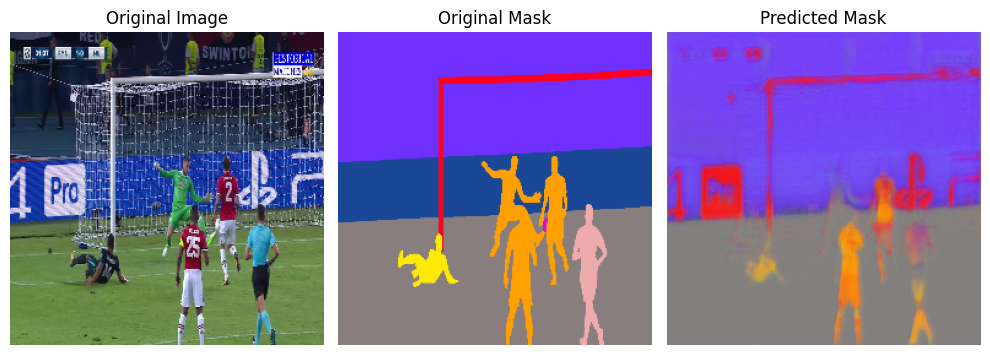

6/6 [==============================] - 700s 118s/step - loss: 0.5319 - accuracy: 0.8953 - val_loss: 0.6404 - val_accuracy: 0.8574
Epoch 24/30
6/6 [==============================] - ETA: 0s - loss: 0.5315 - accuracy: 0.8945  

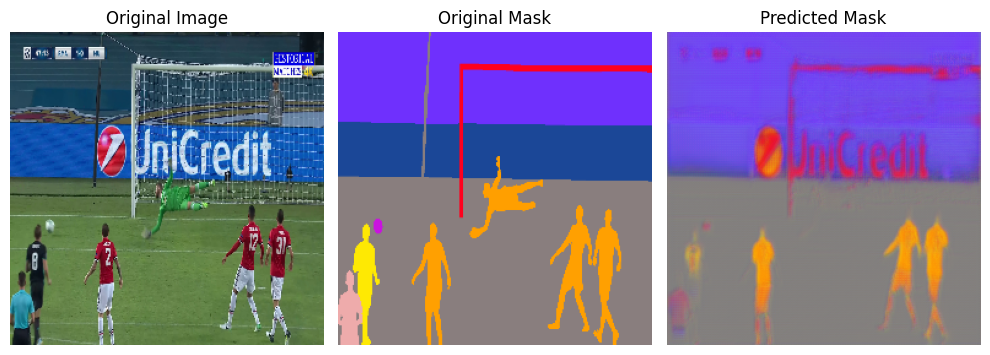

6/6 [==============================] - 688s 114s/step - loss: 0.5315 - accuracy: 0.8945 - val_loss: 0.6402 - val_accuracy: 0.8593
Epoch 25/30
6/6 [==============================] - ETA: 0s - loss: 0.5302 - accuracy: 0.8873  

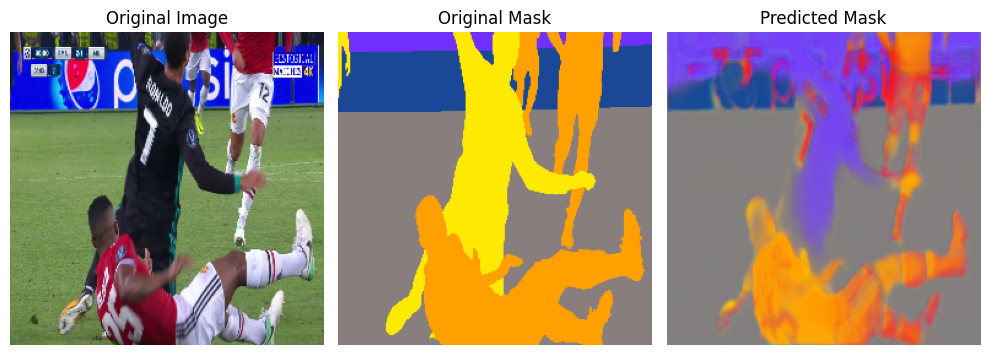

6/6 [==============================] - 701s 116s/step - loss: 0.5302 - accuracy: 0.8873 - val_loss: 0.6495 - val_accuracy: 0.8623
Epoch 26/30
6/6 [==============================] - ETA: 0s - loss: 0.5299 - accuracy: 0.9113  

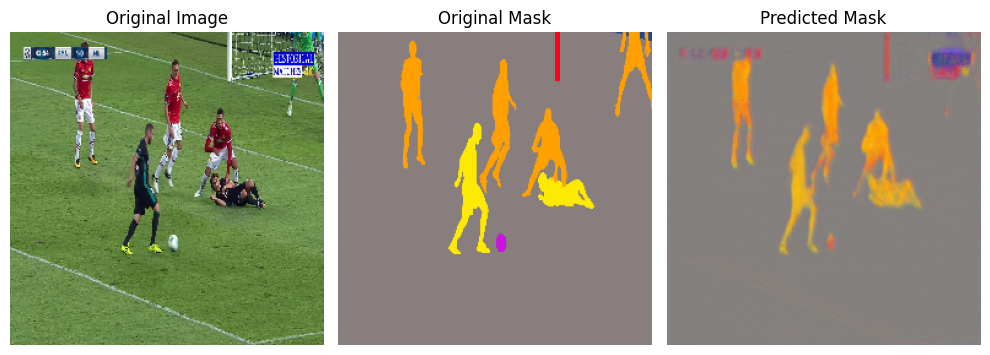

6/6 [==============================] - 691s 116s/step - loss: 0.5299 - accuracy: 0.9113 - val_loss: 0.6281 - val_accuracy: 0.8649
Epoch 27/30
6/6 [==============================] - ETA: 0s - loss: 0.5283 - accuracy: 0.9003  

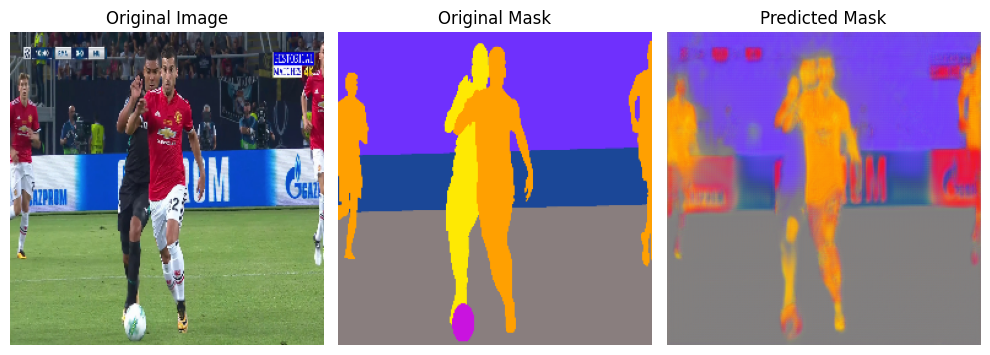

6/6 [==============================] - 682s 115s/step - loss: 0.5283 - accuracy: 0.9003 - val_loss: 0.6345 - val_accuracy: 0.8241
Epoch 28/30
6/6 [==============================] - ETA: 0s - loss: 0.5275 - accuracy: 0.9041  

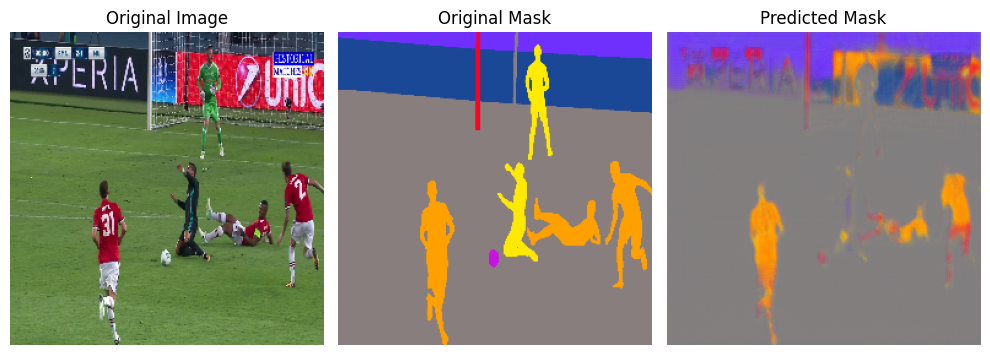

6/6 [==============================] - 682s 115s/step - loss: 0.5275 - accuracy: 0.9041 - val_loss: 0.6354 - val_accuracy: 0.8618
Epoch 29/30
6/6 [==============================] - ETA: 0s - loss: 0.5280 - accuracy: 0.9082  

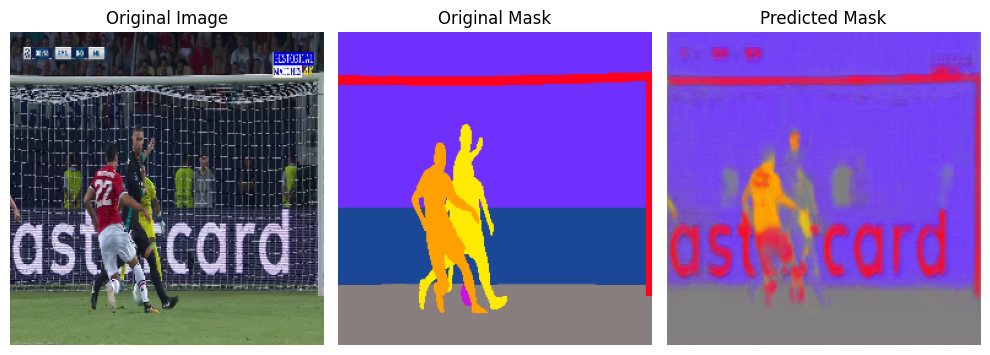

6/6 [==============================] - 678s 114s/step - loss: 0.5280 - accuracy: 0.9082 - val_loss: 0.6333 - val_accuracy: 0.8457
Epoch 30/30
6/6 [==============================] - ETA: 0s - loss: 0.5289 - accuracy: 0.8925  

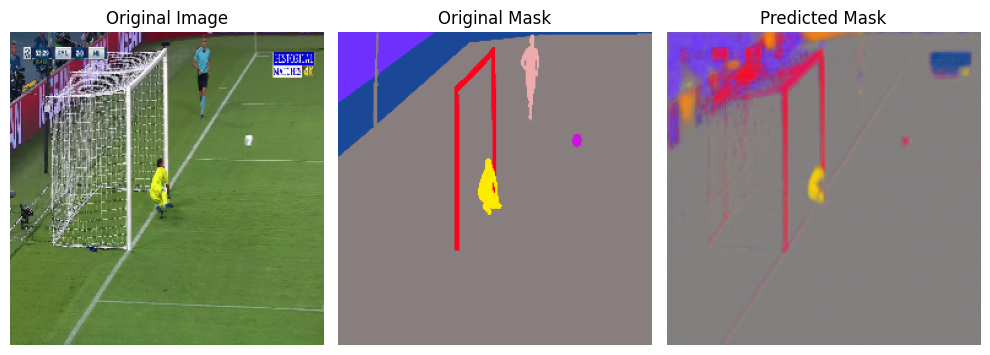

6/6 [==============================] - 690s 116s/step - loss: 0.5289 - accuracy: 0.8925 - val_loss: 0.6305 - val_accuracy: 0.8727


In [ ]:
model.fit(
    images, label_maps,
    validation_split=0.1,
    epochs=30,
    batch_size=BATCH_SIZE,
    steps_per_epoch=SPE,
    callbacks=check_point
)

Model Evalution

In [ ]:
prediction = model.predict(test_images)

1/1 [==============================] - 42s 42s/step


prediction

In [ ]:
def show_predections(test_images , prediction ,test_labels):

    for i in range(len(test_images)):
        plt.figure(figsize=(10,8))
        plt.subplot(1,3,1)
        show_image(test_images[i], title="Original Image")

        plt.subplot(1,3,2)
        show_image(test_labels[i], title="Original Mask")

        plt.subplot(1,3,3)
        show_image(prediction[i], title="Predicted Mask")

        plt.tight_layout()
        plt.show()

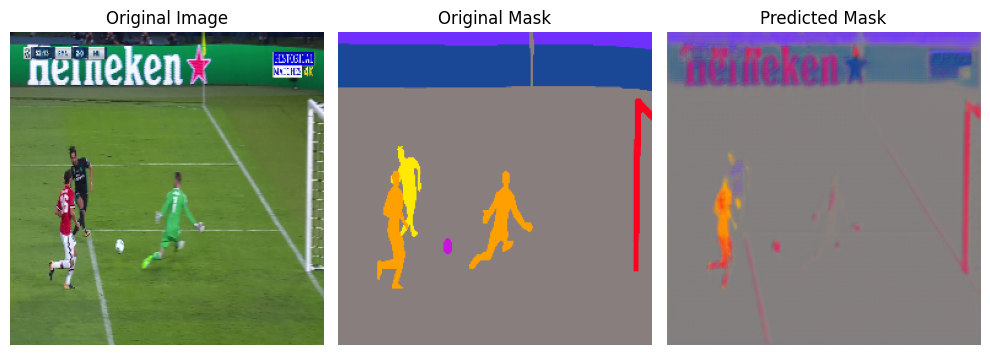

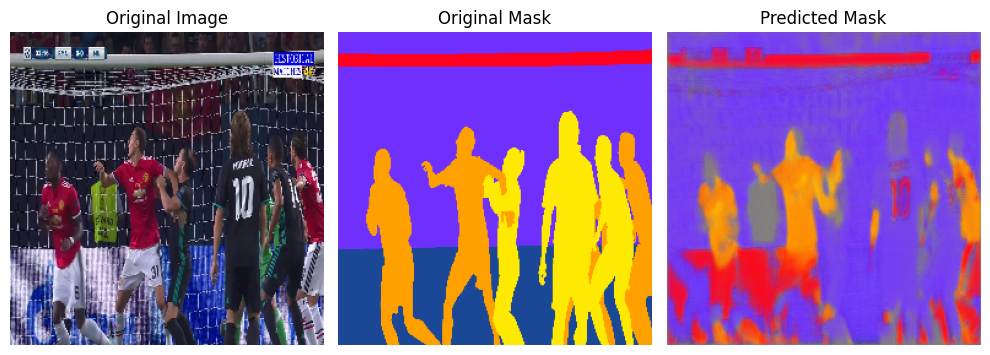

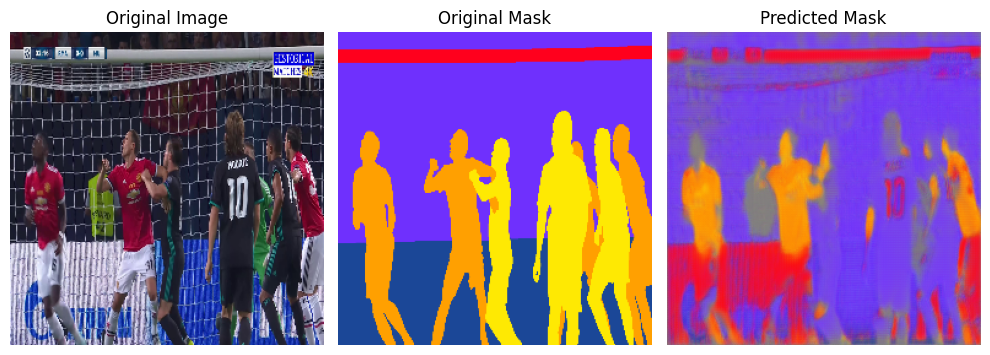

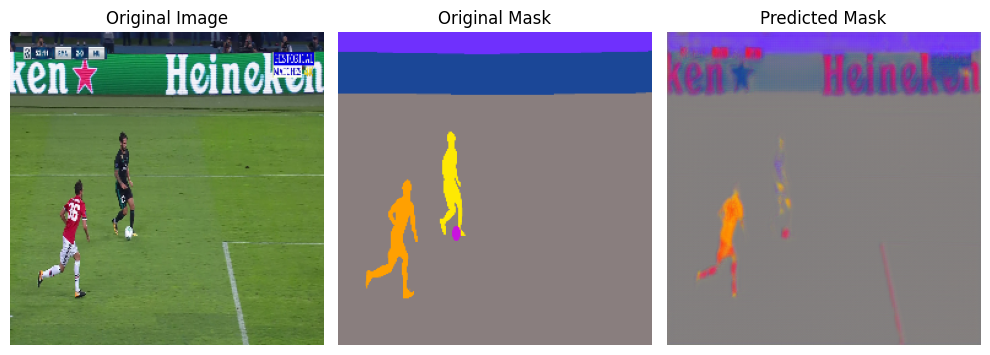

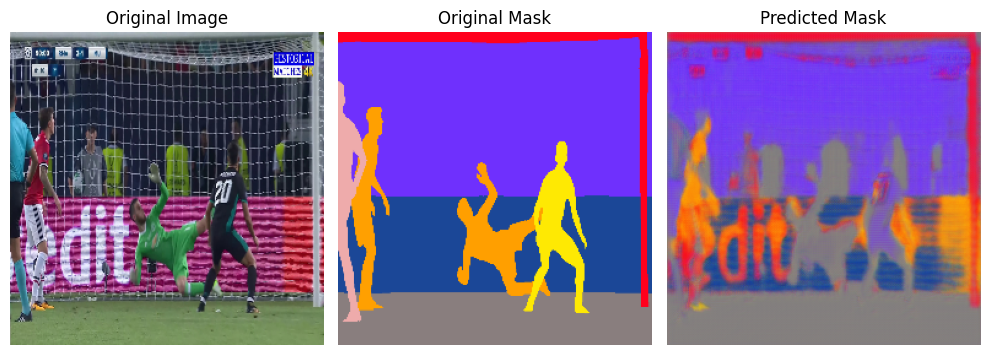

...

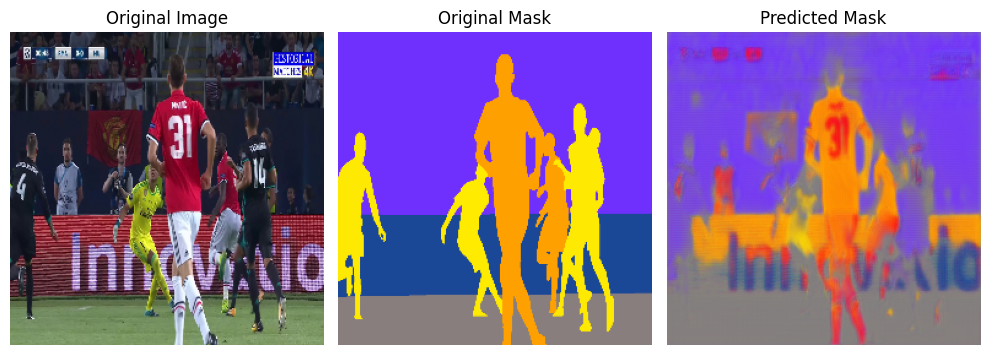

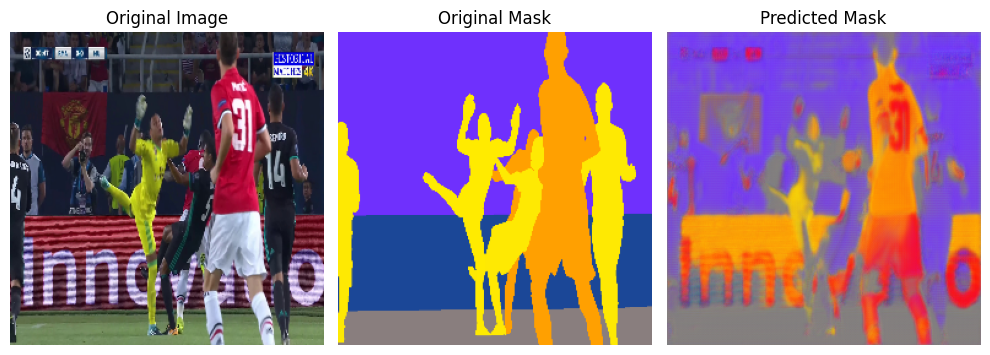

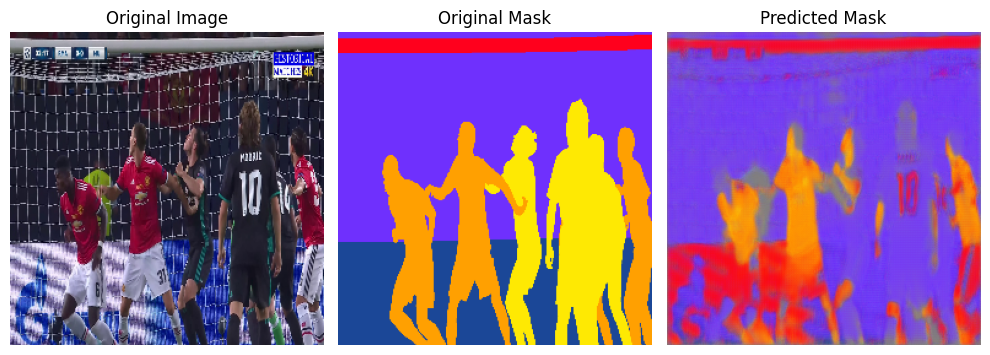

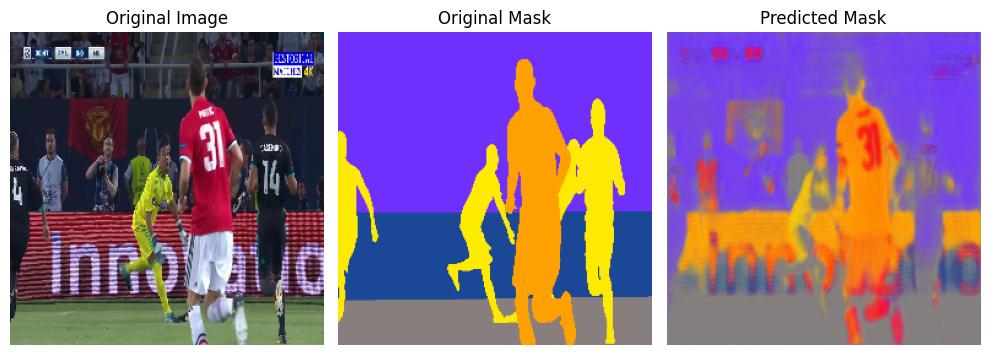

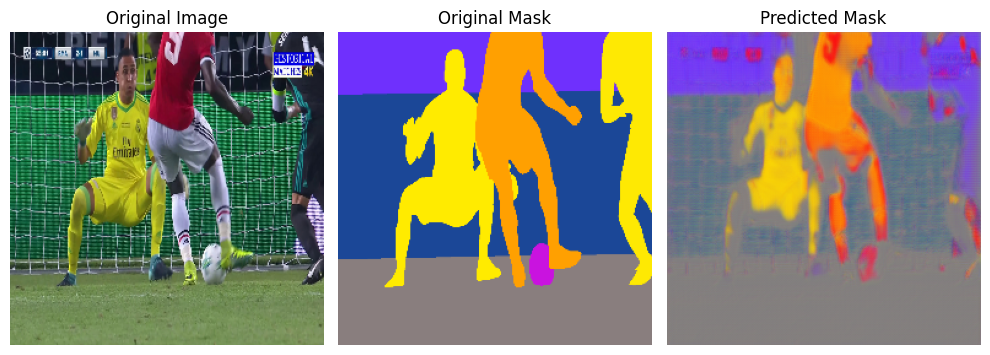

In [ ]:
show_predections(test_images , prediction ,test_labels)